In [1]:
import boto3, math, sagemaker, urllib.request
import pandas as pd
from sagemaker import get_execution_role
from sagemaker.predictor import csv_serializer
import plotly.express as px
import plotly.graph_objects as go
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
from sklearn.linear_model import LinearRegression
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.svm import SVR
from sklearn.ensemble import BaggingRegressor
from sklearn import metrics

In [2]:
role = get_execution_role()
prefix = 'sagemaker/yz726-project3'
my_region = boto3.session.Session().region_name

xgboost_container = sagemaker.image_uris.retrieve("xgboost", my_region, "latest")

print("Success - the MySageMakerInstance is in the " + my_region + " region. I will use the " + xgboost_container + " container for your SageMaker endpoint.")

bucket_name = 'ids721-project3-flight-bucket'
s3 = boto3.resource('s3')
try:
    if  my_region == 'us-east-1':
      s3.create_bucket(Bucket=bucket_name)
    else: 
      s3.create_bucket(Bucket=bucket_name, CreateBucketConfiguration={ 'LocationConstraint': my_region })
    print('S3 bucket created successfully')
except Exception as e:
    print('S3 error: ',e)

Success - the MySageMakerInstance is in the us-east-1 region. I will use the 811284229777.dkr.ecr.us-east-1.amazonaws.com/xgboost:latest container for your SageMaker endpoint.
S3 bucket created successfully


In [3]:
try:
  train_data = pd.read_csv('./Clean_Dataset.csv', index_col=0)
  print('Success: Data loaded into dataframe.')
except Exception as e:
    print('Data train load error: ',e)

Success: Data loaded into dataframe.


In [5]:
train_data.head()

,airline,flight,source_city,departure_time,stops,arrival_time,destination_city,class,duration,days_left,price
0,SpiceJet,SG-8709,Delhi,Evening,zero,Night,Mumbai,Economy,2.17,1,5953
1,SpiceJet,SG-8157,Delhi,Early_Morning,zero,Morning,Mumbai,Economy,2.33,1,5953
2,AirAsia,I5-764,Delhi,Early_Morning,zero,Early_Morning,Mumbai,Economy,2.17,1,5956
3,Vistara,UK-995,Delhi,Morning,zero,Afternoon,Mumbai,Economy,2.25,1,5955
4,Vistara,UK-963,Delhi,Morning,zero,Morning,Mumbai,Economy,2.33,1,5955


In [6]:
train_data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 300153 entries, 0 to 300152
Data columns (total 11 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   airline           300153 non-null  object 
 1   flight            300153 non-null  object 
 2   source_city       300153 non-null  object 
 3   departure_time    300153 non-null  object 
 4   stops             300153 non-null  object 
 5   arrival_time      300153 non-null  object 
 6   destination_city  300153 non-null  object 
 7   class             300153 non-null  object 
 8   duration          300153 non-null  float64
 9   days_left         300153 non-null  int64  
 10  price             300153 non-null  int64  
dtypes: float64(1), int64(2), object(8)
memory usage: 27.5+ MB


In [7]:
train_data.corr(numeric_only = True)

,duration,days_left,price
duration,1.000000,-0.039157,0.204222
days_left,-0.039157,1.000000,-0.091949
price,0.204222,-0.091949,1.000000


In [8]:
train_data_group=train_data.groupby(['flight','airline'],as_index=False).count()
train_data_group.airline.value_counts()

Indigo       704
Air_India    218
GO_FIRST     205
SpiceJet     186
Vistara      133
AirAsia      115
Name: airline, dtype: int64

In [9]:
fig = px.box(train_data, x="airline", y="price")
fig.show()

In [10]:
fig = px.box(train_data, x="class", y="price")
fig.show()

In [11]:
counts = train_data.groupby('source_city').count()['airline']
depart = [i for i,df in train_data.groupby('source_city')]
fig = go.Figure(data=[go.Pie(labels=depart, values=counts)])
fig.show()

In [12]:
counts = train_data.groupby('destination_city').count()['airline']
depart = [i for i,df in train_data.groupby('destination_city')]
fig = go.Figure(data=[go.Pie(labels=depart, values=counts)])
fig.show()

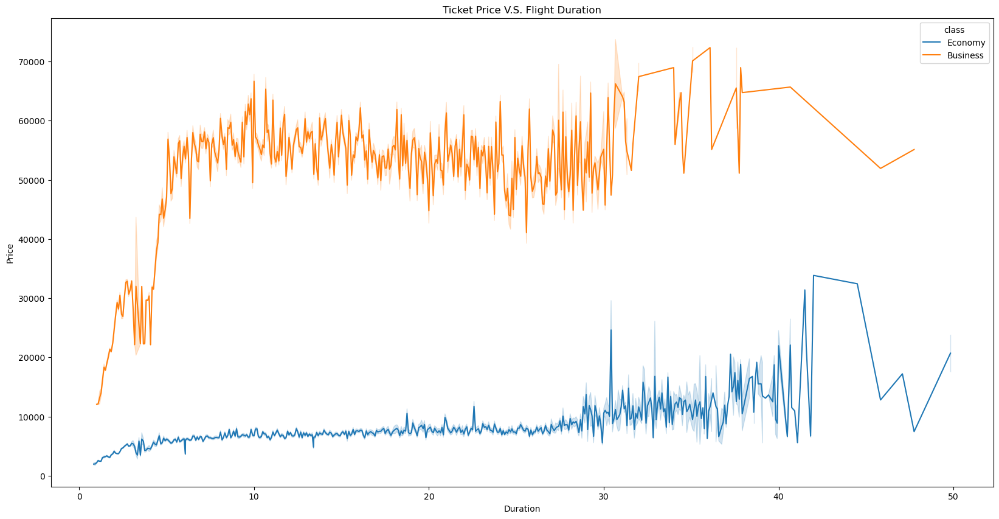

In [13]:
plt.figure(figsize=(20,10))
sns.lineplot(data=train_data,x='duration',y='price',hue='class')
plt.title('Ticket Price V.S. Flight Duration')
plt.xlabel('Duration')
plt.ylabel('Price')
plt.show()

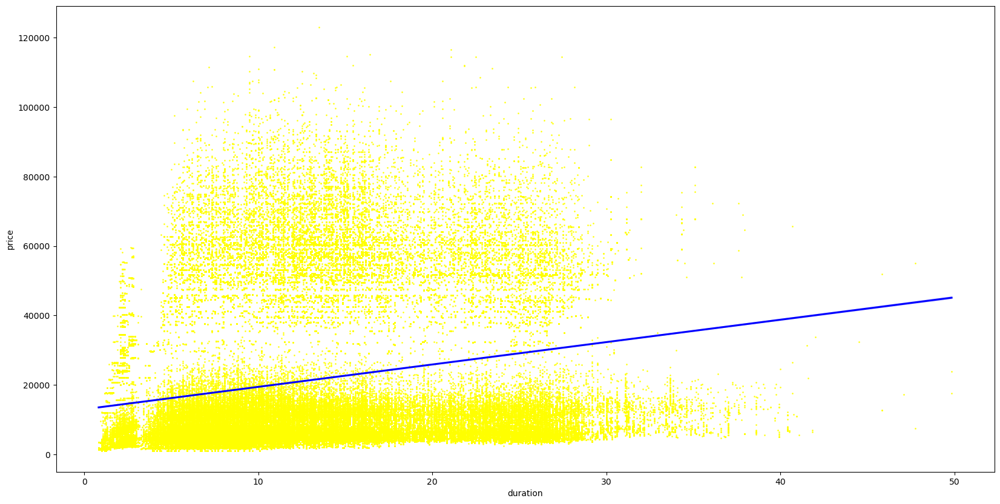

In [14]:
plt.figure(figsize=(20,10))
ax = sns.regplot(x = 'duration', y = 'price', data = train_data, scatter_kws={"color": "yellow", 's':1}, line_kws={"color": "blue"})
plt.show()

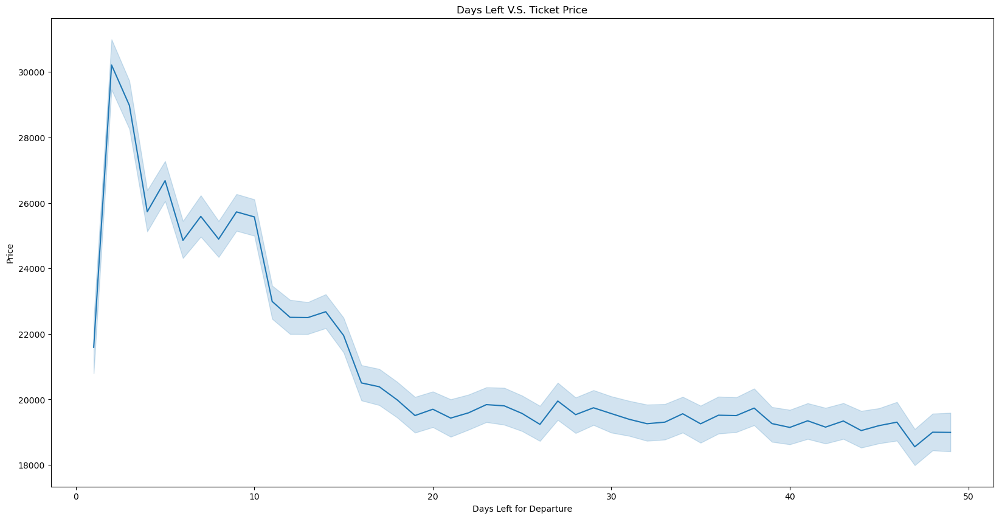

In [15]:
plt.figure(figsize=(20,10))
sns.lineplot(data=train_data,x='days_left',y='price')
plt.title('Days Left V.S. Ticket Price')
plt.xlabel('Days Left for Departure')
plt.ylabel('Price')
plt.show()

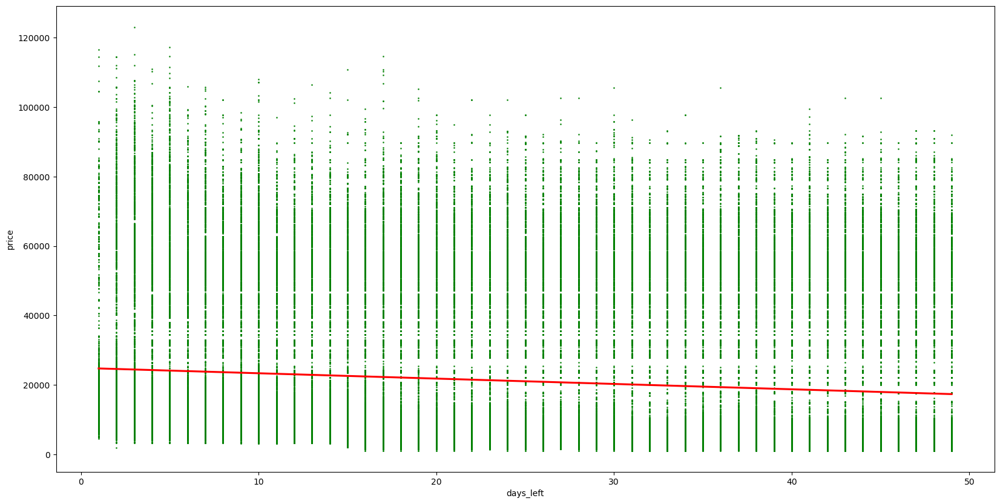

In [16]:
plt.figure(figsize=(20,10))
ax = sns.regplot(x = 'days_left', y = 'price', data = train_data, scatter_kws={"color": "green", 's':1}, line_kws={"color": "red"})
plt.show()

In [4]:
dummy_train_data = train_data
dummy_train_data["stops"] = dummy_train_data["stops"].replace({'zero':0,'one':1,'two_or_more':2}).astype(int)
dummy_train_data["class"] = dummy_train_data["class"].replace({'Business':0,'Economy':1}).astype(int)
var = ["airline","source_city","destination_city","departure_time","arrival_time"]
dummies = pd.get_dummies(dummy_train_data[var], drop_first= True)
dummy_train_data = pd.concat([dummy_train_data,dummies],axis=1)
dummy_train_data = dummy_train_data.drop(["flight","airline","source_city","destination_city","departure_time","arrival_time"],axis=1)
data_corr = dummy_train_data.corr(numeric_only = True)

In [5]:
x=dummy_train_data.drop(['price'],axis=1)
y=dummy_train_data['price']
from sklearn.model_selection import train_test_split
x_train,x_test,y_train,y_test=train_test_split(x,y,test_size=0.30,random_state=42)
x_train.shape,x_test.shape,y_train.shape,y_test.shape

((210107, 29), (90046, 29), (210107,), (90046,))

In [6]:
cols={'Model':[], 'Mean Absolute Error':[] ,'Mean Squared Error':[] ,'Root Mean Squared Error':[] ,'Root Mean Squared Log Error':[] ,'R2':[]}
results=pd.DataFrame(cols)
mlg = LinearRegression()
dcr = DecisionTreeRegressor()
bag = BaggingRegressor()
rfr = RandomForestRegressor()

models = [mlg, dcr, bag, rfr]

for model in models:
    
    model.fit(x_train, y_train)

    y_pred = model.predict(x_test)
 
    test_result = {'Model' : models,
               'Mean Absolute Error' : metrics.mean_absolute_error(y_test, y_pred),
               'Mean Squared Error' : metrics.mean_squared_error(y_test, y_pred),
               'Root Mean Squared Error' : np.sqrt(metrics.mean_squared_error(y_test, y_pred)),
               'Root Mean Squared Log Error': np.log(np.sqrt(metrics.mean_squared_error(y_test, y_pred))),
               'R2' : metrics.r2_score(y_test, y_pred)}
    results = results.append(test_result, ignore_index=True)


/tmp/ipykernel_24769/2699400210.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results = results.append(test_result, ignore_index=True)
/tmp/ipykernel_24769/2699400210.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results = results.append(test_result, ignore_index=True)
/tmp/ipykernel_24769/2699400210.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results = results.append(test_result, ignore_index=True)
/tmp/ipykernel_24769/2699400210.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results = results.append(test_result, ignore_index=True)


In [9]:
results

,Model,Mean Absolute Error,Mean Squared Error,Root Mean Squared Error,Root Mean Squared Log Error,R2
0,"[LinearRegression(), DecisionTreeRegressor(), ...",4503.383571,4.629087e+07,6803.739451,8.825228,0.910057
1,"[LinearRegression(), DecisionTreeRegressor(), ...",1195.628893,1.265739e+07,3557.722389,8.176876,0.975407
2,"[LinearRegression(), DecisionTreeRegressor(), ...",1134.948183,8.533483e+06,2921.212569,7.979754,0.983419
3,"[LinearRegression(), DecisionTreeRegressor(), ...",1104.583288,7.972576e+06,2823.574976,7.945759,0.984509


In [ ]:
fig = px.bar(results, x='Model', y='Mean Absolute Error')
fig.show()